In [4]:
import os
librarypath = "/Users/marssaxman/Music/Track Library"
tracks = {"taphon": "7633973_Taphon_Original_Mix.mp3", 
              "burning sun": "Monolink - Burning Sun (Be Svendsen Remix).mp3",
              "lucid illusions": "09 Lucid Illusions.mp3",
              "new rhythm": "1224427_New_Rhythm_Original_Mix.mp3",
              "entropath": "4547323_Entropath__Whitebear_remix_Whitebear_Remix.mp3"
             }
tracks = dict((id, os.path.join(librarypath, path)) for id, path in tracks.iteritems())


In [5]:
import IPython
IPython.display.Audio(tracks["lucid illusions"])

In [6]:
import essentia
import essentia.standard as es
audio = es.MonoLoader(filename=tracks["new rhythm"])()

In [7]:
rhythm_extractor = es.RhythmExtractor2013(method="multifeature")
bpm, beats, beats_confidence, _, beats_intervals = rhythm_extractor(audio)

print("BPM:", bpm)
print("Beat positions (sec.):", beats)
print("Beat estimation confidence:", beats_confidence)

('BPM:', 124.00267791748047)
('Beat positions (sec.):', array([   0.47600907,    0.96362811,    1.43963718,    1.92725623,
          2.41487527,    2.8908844 ,    3.37850332,    3.86612248,
          4.34213161,    4.82975054,    5.31736946,    5.80498838,
          6.28099775,    6.76861668,    7.24462557,    7.65097475,
          8.03410435,    8.48689365,    8.96290207,    9.43891144,
          9.92653084,   10.41414928,   10.90176868,   11.3777771 ,
         11.8653965 ,   12.34140587,   12.82902431,   13.31664371,
         13.79265308,   14.28027153,   14.76789093,   15.2439003 ,
         15.73151875,   16.21913719,   16.69514656,   17.18276596,
         17.67038536,   18.14639473,   18.63401413,   19.12163162,
         19.59764099,   20.08526039,   20.57287979,   21.06049919,
         21.54811668,   22.02412605,   22.50013542,   22.98775482,
         23.47537422,   23.96299362,   24.45061111,   24.92662048,
         25.41423988,   25.89024925,   26.37786865,   26.86548615,
      

In [8]:
from pylab import plot, show, figure, imshow
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (15, 6) # set plot sizes to something larger than default
import numpy

In [9]:
eqloudio = es.EqloudLoader(filename=tracks["burning sun"], sampleRate=44100)()


In [17]:
pitch_extractor = es.PredominantPitchMelodia(frameSize=2048, hopSize=128)
pitch_values, pitch_confidence = pitch_extractor(eqloudio)
pitch_times = numpy.linspace(0.0,len(eqloudio)/44100.0,len(pitch_values) )

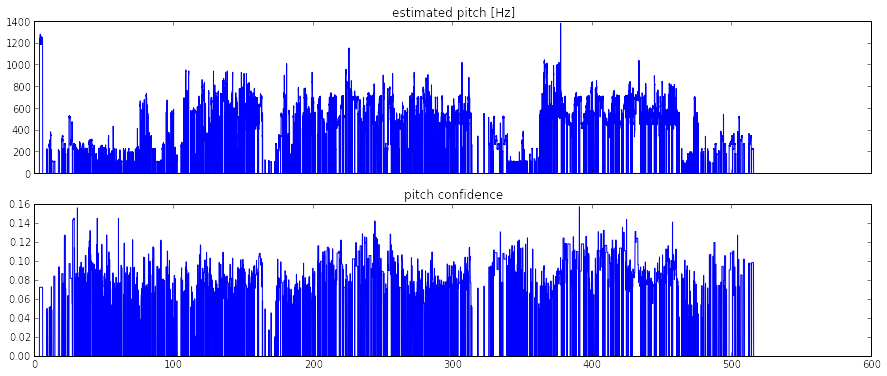

In [18]:
# Plot the estimated pitch contour and confidence over time
f, axarr = plt.subplots(2, sharex=True)
axarr[0].plot(pitch_times, pitch_values)
axarr[0].set_title('estimated pitch [Hz]')
axarr[1].plot(pitch_times, pitch_confidence)
axarr[1].set_title('pitch confidence')
plt.show()